##  <span style="color:#4d7799"> Video Game Sales </span>
<span style="color:#7fa4c4">This dataset contains a list of video games with sales greater than 100,000 copies. It was generated by a scrape of vgchartz.com.</span>
- <span style="color:#b5515b">Fields include</span>
- <span style="color:#b5515b">Rank - Ranking of overall sales</span>
- <span style="color:#b5515b">Name - The games name </span>
- <span style="color:#b5515b">Platform - Platform of the games release (i.e. PC,PS4, etc.)</span>
- <span style="color:#b5515b">Year - Year of the game's release</span>
- <span style="color:#b5515b">Genre - Genre of the game</span>
- <span style="color:#b5515b">Publisher - Publisher of the game</span>
- <span style="color:#b5515b">NA_Sales - Sales in North America (in millions)</span>
- <span style="color:#b5515b">EU_Sales - Sales in Europe (in millions)</span>
- <span style="color:#b5515b">JP_Sales - Sales in Japan (in millions)</span>
- <span style="color:#b5515b">Other_Sales - Sales in the rest of the world (in millions)</span>
- <span style="color:#b5515b">Global_Sales - Total worldwide sales.

There are 16,598 records. 2 records were dropped due to incomplete information.


##### [ReadData](#1)
##### [Clean Data](#2)
##### [DATA ANALYSIS](#3)
##### [Machine Learning](#4)

##  <span style="color:#4d7799"> Importing libraries and Set Options </span>

In [1]:
# imports
import pandas as pd
import seaborn as sns
import numpy as np
import os
import json
import time
import matplotlib.pyplot as plt
import matplotlib.style as style
from matplotlib.colors import ListedColormap
from matplotlib import cm
import seaborn as sns
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True)
%matplotlib inline

#Plotly Libraris
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
from plotly.colors import n_colors
from plotly.subplots import make_subplots
from plotly.offline import init_notebook_mode, iplot
from plotly import tools
from sklearn.preprocessing import StandardScaler , LabelEncoder
from sklearn.model_selection import train_test_split
from  sklearn import linear_model , metrics
from  sklearn.metrics import accuracy_score, confusion_matrix , recall_score , precision_score , f1_score ,classification_report,plot_confusion_matrix



#options
sns.set(style='darkgrid')
pd.set_option('display.max_rows', None)
pd.set_option('display.max_colwidth', None)
# Notbook option
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))


##  <span style="color:#4d7799"> Read Data</span>

<a id='1'></a>

In [2]:
df_vg=pd.read_csv('vgsales.csv')

## <span style="color:#4d7799"> Assess Data</span>

##  <span style="color:#4d7799"> Visual assess</span>

In [3]:
df_vg.head(30)

,Rank,Name,Platform,Year,Genre,Publisher,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales
0,1,Wii Sports,Wii,2006.0,Sports,Nintendo,41.49,29.02,3.77,8.46,82.74
1,2,Super Mario Bros.,NES,1985.0,Platform,Nintendo,29.08,3.58,6.81,0.77,40.24
2,3,Mario Kart Wii,Wii,2008.0,Racing,Nintendo,15.85,12.88,3.79,3.31,35.82
3,4,Wii Sports Resort,Wii,2009.0,Sports,Nintendo,15.75,11.01,3.28,2.96,33.00
4,5,Pokemon Red/Pokemon Blue,GB,1996.0,Role-Playing,Nintendo,11.27,8.89,10.22,1.00,31.37
5,6,Tetris,GB,1989.0,Puzzle,Nintendo,23.20,2.26,4.22,0.58,30.26
6,7,New Super Mario Bros.,DS,2006.0,Platform,Nintendo,11.38,9.23,6.50,2.90,30.01
7,8,Wii Play,Wii,2006.0,Misc,Nintendo,14.03,9.20,2.93,2.85,29.02
8,9,New Super Mario Bros. Wii,Wii,2009.0,Platform,Nintendo,14.59,7.06,4.70,2.26,28.62
9,10,Duck Hunt,NES,1984.0,Shooter,Nintendo,26.93,0.63,0.28,0.47,28.31


In [4]:
df_vg.shape

(16598, 11)

In [5]:
df_vg.sample(25)

,Rank,Name,Platform,Year,Genre,Publisher,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales
5505,5507,GT Advance Championship Racing,GBA,2001.0,Racing,THQ,0.24,0.09,0.00,0.01,0.33
2198,2200,The SpongeBob SquarePants Movie,GC,2004.0,Platform,THQ,0.73,0.19,0.00,0.03,0.94
5788,5790,SD Gundam G Generation: Overworld,PSP,2012.0,Strategy,Namco Bandai Games,0.00,0.00,0.31,0.00,0.31
3905,3907,Dragon Ball: Raging Blast,X360,2009.0,Fighting,Namco Bandai Games,0.36,0.09,0.02,0.04,0.51
15771,15774,Root Infinity Rexx,PSV,2015.0,Adventure,Idea Factory,0.00,0.00,0.02,0.00,0.02
11627,11629,Dragon's Dogma Online,PS4,2015.0,Role-Playing,Capcom,0.00,0.00,0.08,0.00,0.08
13622,13624,The Sims Deluxe,PC,2002.0,Simulation,Electronic Arts,0.01,0.02,0.00,0.01,0.04
7797,7799,Descent,PS,1996.0,Shooter,Interplay,0.11,0.07,0.00,0.01,0.19
6946,6948,Silent Hill: Book of Memories,PSV,2012.0,Action,Konami Digital Entertainment,0.13,0.06,0.00,0.04,0.24
13559,13561,428: Fuusa Sareta Shibuya de,PSP,2009.0,Adventure,Spike,0.00,0.00,0.04,0.00,0.04


In [6]:
df_vg['id']=df_vg.index

##  <span style="color:#4d7799"> Programmatically assess</span>

In [7]:
df_vg.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16598 entries, 0 to 16597
Data columns (total 12 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Rank          16598 non-null  int64  
 1   Name          16598 non-null  object 
 2   Platform      16598 non-null  object 
 3   Year          16327 non-null  float64
 4   Genre         16598 non-null  object 
 5   Publisher     16540 non-null  object 
 6   NA_Sales      16598 non-null  float64
 7   EU_Sales      16598 non-null  float64
 8   JP_Sales      16598 non-null  float64
 9   Other_Sales   16598 non-null  float64
 10  Global_Sales  16598 non-null  float64
 11  id            16598 non-null  int64  
dtypes: float64(6), int64(2), object(4)
memory usage: 1.5+ MB


In [8]:
df_vg.shape

(16598, 12)

In [9]:
df_vg.describe()

,Rank,Year,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales,id
count,16598.000000,16327.000000,16598.000000,16598.000000,16598.000000,16598.000000,16598.000000,16598.000000
mean,8300.605254,2006.406443,0.264667,0.146652,0.077782,0.048063,0.537441,8298.500000
std,4791.853933,5.828981,0.816683,0.505351,0.309291,0.188588,1.555028,4791.574219
min,1.000000,1980.000000,0.000000,0.000000,0.000000,0.000000,0.010000,0.000000
25%,4151.250000,2003.000000,0.000000,0.000000,0.000000,0.000000,0.060000,4149.250000
50%,8300.500000,2007.000000,0.080000,0.020000,0.000000,0.010000,0.170000,8298.500000
75%,12449.750000,2010.000000,0.240000,0.110000,0.040000,0.040000,0.470000,12447.750000
max,16600.000000,2020.000000,41.490000,29.020000,10.220000,10.570000,82.740000,16597.000000


In [10]:
df_vg['Global_Sales'].describe()

count    16598.000000
mean         0.537441
std          1.555028
min          0.010000
25%          0.060000
50%          0.170000
75%          0.470000
max         82.740000
Name: Global_Sales, dtype: float64

In [11]:
df_vg.loc[df_vg['Year']==2020.0]

,Rank,Name,Platform,Year,Genre,Publisher,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales,id
5957,5959,Imagine: Makeup Artist,DS,2020.0,Simulation,Ubisoft,0.27,0.0,0.0,0.02,0.29,5957


In [12]:
df_vg.loc[df_vg['Rank']==14779]

,Rank,Name,Platform,Year,Genre,Publisher,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales,id
14776,14779,3DS Classic Collection,3DS,2016.0,Misc,Sega,0.02,0.0,0.0,0.0,0.03,14776


In [13]:
for ind in df_vg.index :    
    if df_vg.NA_Sales[ind] + df_vg.EU_Sales[ind] + df_vg.JP_Sales[ind] + df_vg.Other_Sales[ind] != df_vg.Global_Sales[ind] :
        print (ind,df_vg.NA_Sales[ind] + df_vg.EU_Sales[ind] + df_vg.JP_Sales[ind] + df_vg.Other_Sales[ind],df_vg.Global_Sales[ind])

0 82.74000000000001 82.74
2 35.830000000000005 35.82
4 31.380000000000003 31.37
5 30.259999999999998 30.26
6 30.009999999999998 30.01
7 29.009999999999998 29.02
8 28.61 28.62
10 24.75 24.76
11 23.43 23.42
12 23.09 23.1
16 21.39 21.4
17 20.810000000000002 20.81
18 20.62 20.61
19 20.220000000000002 20.22
20 18.35 18.36
23 16.380000000000003 16.38
24 16.150000000000002 16.15
25 15.84 15.85
28 14.969999999999999 14.98
32 14.349999999999998 14.35
33 14.239999999999998 14.24
34 14.040000000000001 14.03
35 13.740000000000002 13.73
36 13.52 13.51
37 13.469999999999999 13.46
38 13.100000000000001 13.1
40 12.730000000000002 12.73
41 12.280000000000001 12.27
44 11.989999999999998 11.98
45 11.899999999999999 11.9
46 11.9 11.89
47 11.649999999999999 11.66
50 11.179999999999998 11.18
51 11.03 11.02
55 10.690000000000001 10.69
56 10.579999999999998 10.57
60 10.27 10.26
61 10.209999999999999 10.21
62 9.87 9.88
63 9.870000000000001 9.87
64 9.830000000000002 9.82
66 9.719999999999999 9.72
67 9.580000000

839 2.02 2.03
845 1.9999999999999998 2.01
848 2.0100000000000002 2.0
851 1.9899999999999998 1.99
852 1.9900000000000002 1.99
853 1.9900000000000002 1.99
855 1.9900000000000002 1.98
856 1.99 1.98
857 1.9700000000000002 1.98
858 1.9800000000000002 1.97
861 1.98 1.97
864 1.9700000000000002 1.97
869 1.9500000000000002 1.96
870 1.9600000000000002 1.96
873 1.9600000000000002 1.95
874 1.9500000000000002 1.95
879 1.9499999999999997 1.94
881 1.9300000000000002 1.94
882 1.93 1.94
885 1.9299999999999997 1.93
886 1.9300000000000002 1.93
887 1.9300000000000002 1.93
888 1.9300000000000002 1.93
889 1.9300000000000002 1.93
891 1.9200000000000004 1.93
892 1.92 1.93
893 1.91 1.92
894 1.9200000000000002 1.92
895 1.93 1.92
898 1.9200000000000002 1.92
900 1.91 1.92
901 1.91 1.92
902 1.9100000000000001 1.91
903 1.9 1.91
905 1.9000000000000001 1.91
906 1.9100000000000001 1.91
907 1.9000000000000001 1.9
908 1.8900000000000001 1.9
909 1.8900000000000001 1.89
911 1.8800000000000001 1.89
912 1.8800000000000001 1

1505 1.3 1.31
1510 1.2999999999999998 1.31
1511 1.3000000000000003 1.31
1514 1.31 1.3
1515 1.29 1.3
1518 1.31 1.3
1519 1.2999999999999998 1.3
1522 1.2900000000000003 1.3
1523 1.3000000000000003 1.3
1524 1.29 1.3
1526 1.2900000000000003 1.29
1528 1.28 1.29
1529 1.3 1.29
1533 1.28 1.29
1534 1.2800000000000002 1.29
1535 1.2800000000000002 1.29
1536 1.2799999999999998 1.29
1537 1.28 1.29
1539 1.29 1.28
1540 1.2800000000000002 1.28
1544 1.2800000000000002 1.28
1546 1.27 1.28
1548 1.26 1.28
1549 1.2699999999999998 1.28
1550 1.28 1.27
1558 1.2600000000000002 1.27
1563 1.2599999999999998 1.27
1565 1.26 1.27
1566 1.26 1.27
1567 1.2600000000000002 1.27
1569 1.27 1.26
1570 1.2500000000000002 1.26
1572 1.2600000000000002 1.26
1574 1.2600000000000002 1.26
1575 1.25 1.26
1578 1.2600000000000002 1.26
1579 1.25 1.26
1580 1.2500000000000002 1.26
1581 1.25 1.26
1582 1.2599999999999998 1.25
1589 1.2600000000000002 1.25
1591 1.24 1.25
1592 1.24 1.25
1593 1.24 1.25
1594 1.2499999999999998 1.25
1597 1.24000

2702 0.7599999999999999 0.76
2708 0.7599999999999999 0.76
2710 0.7600000000000001 0.76
2711 0.7599999999999999 0.76
2715 0.75 0.76
2719 0.75 0.76
2720 0.75 0.76
2721 0.7499999999999999 0.76
2722 0.7599999999999999 0.76
2724 0.7599999999999999 0.76
2725 0.7600000000000001 0.76
2729 0.76 0.75
2730 0.76 0.75
2732 0.76 0.75
2733 0.7599999999999999 0.75
2734 0.76 0.75
2736 0.7499999999999999 0.75
2741 0.7599999999999999 0.75
2745 0.7500000000000001 0.75
2746 0.7500000000000001 0.75
2750 0.74 0.75
2751 0.76 0.75
2755 0.74 0.75
2759 0.74 0.75
2760 0.7399999999999999 0.75
2761 0.7400000000000001 0.75
2762 0.75 0.74
2765 0.75 0.74
2767 0.75 0.74
2771 0.75 0.74
2776 0.75 0.74
2777 0.7300000000000001 0.74
2781 0.73 0.74
2782 0.7399999999999999 0.74
2787 0.73 0.74
2789 0.73 0.74
2792 0.74 0.73
2793 0.74 0.73
2794 0.7400000000000001 0.73
2796 0.7300000000000001 0.73
2799 0.7300000000000001 0.73
2800 0.72 0.73
2803 0.74 0.73
2805 0.7300000000000001 0.73
2806 0.7300000000000001 0.73
2809 0.7300000000

3461 0.5800000000000001 0.58
3462 0.5700000000000001 0.58
3463 0.5700000000000001 0.58
3464 0.5800000000000001 0.58
3465 0.5700000000000001 0.58
3466 0.5800000000000001 0.58
3467 0.5800000000000001 0.58
3468 0.5700000000000001 0.58
3469 0.5700000000000001 0.58
3470 0.5900000000000001 0.58
3471 0.5800000000000001 0.58
3472 0.5800000000000001 0.58
3473 0.5700000000000001 0.58
3474 0.5800000000000001 0.58
3476 0.5800000000000001 0.58
3477 0.5800000000000001 0.58
3478 0.5700000000000001 0.58
3479 0.5700000000000001 0.58
3480 0.5800000000000001 0.58
3482 0.5700000000000001 0.58
3483 0.57 0.58
3484 0.5800000000000001 0.58
3486 0.5800000000000001 0.58
3487 0.5800000000000001 0.58
3488 0.5800000000000001 0.58
3489 0.5800000000000001 0.58
3490 0.5900000000000001 0.58
3491 0.5800000000000001 0.58
3492 0.5700000000000001 0.58
3494 0.5700000000000001 0.58
3495 0.5800000000000001 0.58
3496 0.5800000000000001 0.58
3497 0.5800000000000001 0.58
3498 0.5800000000000001 0.58
3499 0.5700000000000001 0.58

4764 0.41000000000000003 0.41
4766 0.41000000000000003 0.41
4771 0.41000000000000003 0.41
4772 0.41000000000000003 0.41
4773 0.4 0.41
4776 0.41000000000000003 0.41
4777 0.39999999999999997 0.41
4778 0.41000000000000003 0.4
4779 0.41000000000000003 0.4
4781 0.41000000000000003 0.4
4785 0.41 0.4
4786 0.41 0.4
4787 0.41000000000000003 0.4
4789 0.41 0.4
4790 0.41000000000000003 0.4
4791 0.41 0.4
4793 0.41 0.4
4795 0.39 0.4
4796 0.39999999999999997 0.4
4797 0.39999999999999997 0.4
4798 0.41000000000000003 0.4
4800 0.4000000000000001 0.4
4801 0.39 0.4
4802 0.39999999999999997 0.4
4804 0.3999999999999999 0.4
4808 0.39999999999999997 0.4
4809 0.41 0.4
4810 0.41000000000000003 0.4
4814 0.41 0.4
4818 0.41000000000000003 0.4
4820 0.41 0.4
4826 0.39 0.4
4827 0.39 0.4
4829 0.39 0.4
4830 0.39999999999999997 0.4
4831 0.39 0.4
4834 0.39999999999999997 0.4
4835 0.39999999999999997 0.4
4836 0.39 0.4
4837 0.38999999999999996 0.4
4838 0.39999999999999997 0.4
4840 0.41 0.4
4841 0.39 0.4
4844 0.399999999999

5523 0.32000000000000006 0.33
5526 0.32999999999999996 0.33
5527 0.33999999999999997 0.33
5530 0.33000000000000007 0.33
5531 0.32 0.33
5532 0.33000000000000007 0.33
5534 0.33999999999999997 0.33
5537 0.32 0.33
5538 0.33999999999999997 0.33
5542 0.33999999999999997 0.33
5543 0.32999999999999996 0.33
5544 0.32999999999999996 0.33
5547 0.33000000000000007 0.33
5550 0.32999999999999996 0.33
5552 0.32 0.33
5553 0.32999999999999996 0.33
5556 0.32999999999999996 0.33
5558 0.32000000000000006 0.33
5561 0.32 0.33
5563 0.32 0.33
5564 0.32 0.33
5565 0.32000000000000006 0.33
5566 0.32 0.33
5569 0.32 0.33
5570 0.32 0.33
5571 0.32 0.33
5572 0.32 0.33
5574 0.32999999999999996 0.33
5575 0.32000000000000006 0.32
5576 0.32999999999999996 0.32
5577 0.32000000000000006 0.32
5578 0.33 0.32
5579 0.33 0.32
5582 0.33 0.32
5585 0.33000000000000007 0.32
5586 0.32000000000000006 0.32
5587 0.33 0.32
5588 0.32999999999999996 0.32
5589 0.31999999999999995 0.32
5591 0.32000000000000006 0.32
5592 0.31000000000000005 

6272 0.28 0.27
6274 0.28 0.27
6275 0.28 0.27
6277 0.28 0.27
6282 0.28 0.27
6286 0.26 0.27
6288 0.28 0.27
6291 0.26999999999999996 0.27
6293 0.28 0.27
6297 0.28 0.27
6299 0.26 0.27
6304 0.26 0.27
6310 0.26 0.27
6311 0.26 0.27
6313 0.28 0.27
6315 0.28 0.27
6323 0.26 0.27
6324 0.26 0.27
6325 0.27999999999999997 0.27
6331 0.26 0.27
6333 0.26 0.27
6337 0.26 0.27
6347 0.28 0.27
6348 0.26 0.27
6351 0.26 0.27
6352 0.28 0.27
6354 0.26 0.27
6356 0.26 0.27
6364 0.28 0.27
6365 0.26999999999999996 0.27
6371 0.26 0.27
6373 0.26 0.27
6381 0.26 0.27
6387 0.26 0.27
6392 0.26 0.27
6394 0.26 0.27
6396 0.26 0.27
6397 0.26 0.27
6400 0.26 0.27
6407 0.26 0.27
6408 0.26 0.27
6409 0.26 0.27
6410 0.26 0.27
6415 0.26 0.27
6416 0.26 0.27
6420 0.26 0.27
6425 0.26 0.27
6426 0.26 0.27
6428 0.26 0.27
6430 0.26 0.27
6431 0.26 0.27
6432 0.26 0.27
6434 0.26 0.27
6435 0.26 0.27
6437 0.26 0.27
6440 0.27 0.26
6442 0.27 0.26
6447 0.24999999999999997 0.26
6448 0.27 0.26
6451 0.27 0.26
6456 0.27 0.26
6458 0.27 0.26
6462 0.27 

8015 0.18000000000000002 0.18
8016 0.18000000000000002 0.18
8017 0.18000000000000002 0.18
8018 0.19000000000000003 0.18
8020 0.19 0.18
8023 0.19000000000000003 0.18
8024 0.19 0.18
8027 0.18000000000000002 0.18
8029 0.19 0.18
8030 0.18999999999999997 0.18
8032 0.18000000000000002 0.18
8033 0.19000000000000003 0.18
8035 0.18000000000000002 0.18
8036 0.19 0.18
8039 0.18999999999999997 0.18
8040 0.19 0.18
8042 0.19000000000000003 0.18
8043 0.19000000000000003 0.18
8045 0.19000000000000003 0.18
8046 0.18000000000000002 0.18
8048 0.19 0.18
8051 0.18000000000000002 0.18
8056 0.18000000000000002 0.18
8063 0.17000000000000004 0.18
8064 0.18000000000000002 0.18
8065 0.18000000000000002 0.18
8068 0.18000000000000002 0.18
8069 0.18000000000000002 0.18
8072 0.18999999999999997 0.18
8073 0.18000000000000002 0.18
8074 0.18000000000000002 0.18
8075 0.18999999999999997 0.18
8079 0.18000000000000002 0.18
8080 0.19 0.18
8084 0.18000000000000002 0.18
8086 0.18000000000000002 0.18
8088 0.19000000000000003 

8813 0.15000000000000002 0.15
8815 0.15000000000000002 0.15
8816 0.15000000000000002 0.15
8817 0.15000000000000002 0.15
8819 0.15000000000000002 0.15
8820 0.14 0.15
8821 0.15999999999999998 0.15
8823 0.14 0.15
8825 0.15000000000000002 0.15
8826 0.15000000000000002 0.15
8827 0.15000000000000002 0.15
8828 0.15000000000000002 0.15
8829 0.15000000000000002 0.15
8831 0.15000000000000002 0.15
8833 0.13999999999999999 0.15
8836 0.16000000000000003 0.15
8837 0.15000000000000002 0.15
8838 0.15000000000000002 0.15
8841 0.15000000000000002 0.15
8845 0.15000000000000002 0.15
8847 0.15000000000000002 0.15
8850 0.16 0.15
8853 0.16 0.15
8856 0.15000000000000002 0.15
8867 0.15000000000000002 0.15
8868 0.15000000000000002 0.15
8869 0.15000000000000002 0.15
8870 0.15000000000000002 0.15
8871 0.15000000000000002 0.15
8873 0.15000000000000002 0.15
8876 0.15000000000000002 0.15
8877 0.15000000000000002 0.15
8878 0.14 0.15
8880 0.15000000000000002 0.15
8884 0.15000000000000002 0.15
8885 0.14 0.15
8886 0.150

10692 0.09999999999999999 0.1
10693 0.09000000000000001 0.1
10695 0.09999999999999999 0.1
10699 0.09999999999999999 0.1
10700 0.09999999999999999 0.1
10701 0.09999999999999999 0.1
10702 0.09999999999999999 0.1
10706 0.09999999999999999 0.1
10707 0.09999999999999999 0.1
10709 0.09 0.1
10712 0.09999999999999999 0.1
10713 0.09 0.1
10714 0.09000000000000001 0.1
10716 0.09999999999999999 0.1
10717 0.09999999999999999 0.1
10718 0.09999999999999999 0.1
10719 0.09 0.1
10721 0.09999999999999999 0.1
10722 0.09999999999999999 0.1
10724 0.09999999999999999 0.1
10725 0.09999999999999999 0.1
10726 0.09 0.1
10727 0.09999999999999999 0.1
10728 0.09999999999999999 0.1
10729 0.09999999999999999 0.1
10730 0.09999999999999999 0.1
10731 0.09999999999999999 0.1
10732 0.09999999999999999 0.1
10734 0.09 0.1
10735 0.09000000000000001 0.1
10736 0.09999999999999999 0.1
10737 0.09999999999999999 0.1
10738 0.09 0.1
10740 0.09999999999999999 0.1
10742 0.09999999999999999 0.1
10743 0.09999999999999999 0.1
10744 0.09

11430 0.07 0.08
11431 0.09 0.08
11432 0.09 0.08
11436 0.09 0.08
11439 0.09 0.08
11441 0.07999999999999999 0.08
11442 0.07999999999999999 0.08
11443 0.09 0.08
11452 0.09 0.08
11453 0.09 0.08
11467 0.07999999999999999 0.08
11468 0.07999999999999999 0.08
11471 0.09 0.08
11482 0.09 0.08
11488 0.07999999999999999 0.08
11512 0.07999999999999999 0.08
11519 0.07 0.08
11522 0.07 0.08
11523 0.07 0.08
11532 0.07999999999999999 0.08
11542 0.07999999999999999 0.08
11552 0.07999999999999999 0.08
11562 0.07999999999999999 0.08
11564 0.07999999999999999 0.08
11582 0.09 0.08
11584 0.07999999999999999 0.08
11592 0.09 0.08
11601 0.09 0.08
11602 0.07999999999999999 0.08
11603 0.06999999999999999 0.08
11607 0.07999999999999999 0.08
11608 0.07 0.08
11618 0.07 0.08
11642 0.07 0.08
11644 0.07999999999999999 0.08
11646 0.07 0.08
11656 0.07 0.08
11664 0.06999999999999999 0.08
11665 0.07 0.08
11666 0.07999999999999999 0.08
11667 0.07 0.08
11669 0.07 0.08
11673 0.07 0.08
11675 0.07 0.08
11678 0.07999999999999999 

12317 0.060000000000000005 0.06
12319 0.060000000000000005 0.06
12322 0.06999999999999999 0.06
12323 0.060000000000000005 0.06
12326 0.060000000000000005 0.06
12327 0.060000000000000005 0.06
12328 0.060000000000000005 0.06
12329 0.06999999999999999 0.06
12331 0.060000000000000005 0.06
12332 0.06999999999999999 0.06
12333 0.06999999999999999 0.06
12339 0.060000000000000005 0.06
12340 0.07 0.06
12342 0.060000000000000005 0.06
12343 0.07 0.06
12344 0.060000000000000005 0.06
12345 0.06999999999999999 0.06
12347 0.060000000000000005 0.06
12348 0.060000000000000005 0.06
12352 0.060000000000000005 0.06
12353 0.060000000000000005 0.06
12360 0.060000000000000005 0.06
12366 0.060000000000000005 0.06
12371 0.07 0.06
12377 0.060000000000000005 0.06
12379 0.060000000000000005 0.06
12382 0.05 0.06
12383 0.060000000000000005 0.06
12384 0.060000000000000005 0.06
12387 0.060000000000000005 0.06
12388 0.060000000000000005 0.06
12390 0.060000000000000005 0.06
12391 0.05 0.06
12395 0.05 0.06
12396 0.06000

13220 0.04 0.05
13223 0.04 0.05
13227 0.04 0.05
13231 0.04 0.05
13237 0.04 0.05
13248 0.04 0.05
13252 0.04 0.05
13256 0.04 0.05
13257 0.04 0.05
13259 0.04 0.05
13264 0.04 0.05
13281 0.04 0.05
13286 0.04 0.05
13289 0.04 0.05
13292 0.04 0.05
13293 0.04 0.05
13294 0.04 0.05
13295 0.04 0.05
13297 0.04 0.05
13298 0.04 0.05
13300 0.04 0.05
13302 0.04 0.05
13303 0.04 0.05
13305 0.04 0.05
13308 0.04 0.05
13309 0.04 0.05
13320 0.04 0.05
13322 0.04 0.05
13323 0.04 0.05
13327 0.04 0.05
13328 0.04 0.05
13333 0.04 0.05
13334 0.04 0.05
13337 0.04 0.05
13339 0.04 0.05
13340 0.04 0.05
13343 0.04 0.05
13344 0.04 0.05
13345 0.04 0.05
13348 0.04 0.05
13352 0.04 0.05
13353 0.04 0.05
13354 0.04 0.05
13355 0.04 0.05
13356 0.04 0.05
13358 0.04 0.05
13359 0.04 0.05
13362 0.04 0.05
13369 0.04 0.05
13371 0.04 0.05
13372 0.04 0.05
13377 0.04 0.05
13378 0.04 0.05
13380 0.04 0.05
13381 0.04 0.05
13383 0.04 0.05
13385 0.04 0.05
13389 0.04 0.05
13390 0.04 0.05
13392 0.04 0.05
13393 0.04 0.05
13394 0.04 0.05
13395 0.

16135 0.02 0.01
16154 0.02 0.01
16175 0.02 0.01
16193 0.02 0.01
16222 0.02 0.01
16284 0.02 0.01
16465 0.02 0.01
16595 0.0 0.01


In [14]:
df_vg.loc[df_vg['id']==37]

,Rank,Name,Platform,Year,Genre,Publisher,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales,id
37,38,Call of Duty: Modern Warfare 3,PS3,2011.0,Shooter,Activision,5.54,5.82,0.49,1.62,13.46,37


In [15]:
df_vg.isna().sum()

Rank              0
Name              0
Platform          0
Year            271
Genre             0
Publisher        58
NA_Sales          0
EU_Sales          0
JP_Sales          0
Other_Sales       0
Global_Sales      0
id                0
dtype: int64

In [16]:
df_vg.loc[df_vg['Year'].isna() ]

,Rank,Name,Platform,Year,Genre,Publisher,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales,id
179,180,Madden NFL 2004,PS2,NaN,Sports,Electronic Arts,4.26,0.26,0.01,0.71,5.23,179
377,378,FIFA Soccer 2004,PS2,NaN,Sports,Electronic Arts,0.59,2.36,0.04,0.51,3.49,377
431,432,LEGO Batman: The Videogame,Wii,NaN,Action,Warner Bros. Interactive Entertainment,1.86,1.02,0.00,0.29,3.17,431
470,471,wwe Smackdown vs. Raw 2006,PS2,NaN,Fighting,NaN,1.57,1.02,0.00,0.41,3.00,470
607,608,Space Invaders,2600,NaN,Shooter,Atari,2.36,0.14,0.00,0.03,2.53,607
624,625,Rock Band,X360,NaN,Misc,Electronic Arts,1.93,0.34,0.00,0.21,2.48,624
649,650,Frogger's Adventures: Temple of the Frog,GBA,NaN,Adventure,Konami Digital Entertainment,2.15,0.18,0.00,0.07,2.39,649
652,653,LEGO Indiana Jones: The Original Adventures,Wii,NaN,Action,LucasArts,1.54,0.63,0.00,0.22,2.39,652
711,713,Call of Duty 3,Wii,NaN,Shooter,Activision,1.19,0.84,0.00,0.23,2.26,711
782,784,Rock Band,Wii,NaN,Misc,MTV Games,1.35,0.56,0.00,0.20,2.11,782


In [17]:
df_vg.loc[df_vg['Publisher'].isna() ]

,Rank,Name,Platform,Year,Genre,Publisher,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales,id
470,471,wwe Smackdown vs. Raw 2006,PS2,NaN,Fighting,NaN,1.57,1.02,0.00,0.41,3.00,470
1303,1305,Triple Play 99,PS,NaN,Sports,NaN,0.81,0.55,0.00,0.10,1.46,1303
1662,1664,Shrek / Shrek 2 2-in-1 Gameboy Advance Video,GBA,2007.0,Misc,NaN,0.87,0.32,0.00,0.02,1.21,1662
2222,2224,Bentley's Hackpack,GBA,2005.0,Misc,NaN,0.67,0.25,0.00,0.02,0.93,2222
3159,3161,Nicktoons Collection: Game Boy Advance Video Volume 1,GBA,2004.0,Misc,NaN,0.46,0.17,0.00,0.01,0.64,3159
3166,3168,SpongeBob SquarePants: Game Boy Advance Video Volume 1,GBA,2004.0,Misc,NaN,0.46,0.17,0.00,0.01,0.64,3166
3766,3768,SpongeBob SquarePants: Game Boy Advance Video Volume 2,GBA,2004.0,Misc,NaN,0.38,0.14,0.00,0.01,0.53,3766
4145,4147,Sonic the Hedgehog,PS3,NaN,Platform,NaN,0.00,0.48,0.00,0.00,0.48,4145
4526,4528,The Fairly Odd Parents: Game Boy Advance Video Volume 1,GBA,2004.0,Misc,NaN,0.31,0.11,0.00,0.01,0.43,4526
4635,4637,The Fairly Odd Parents: Game Boy Advance Video Volume 2,GBA,2004.0,Misc,NaN,0.30,0.11,0.00,0.01,0.42,4635


In [18]:
df_vg.Name.value_counts()

Need for Speed: Most Wanted                                                                                                             12
Ratatouille                                                                                                                              9
LEGO Marvel Super Heroes                                                                                                                 9
FIFA 14                                                                                                                                  9
Madden NFL 07                                                                                                                            9
Terraria                                                                                                                                 8
LEGO Star Wars II: The Original Trilogy                                                                                                  8
FIFA Soccer 13             

In [19]:
df_vg.Platform.value_counts()

DS      2163
PS2     2161
PS3     1329
Wii     1325
X360    1265
PSP     1213
PS      1196
PC       960
XB       824
GBA      822
GC       556
3DS      509
PSV      413
PS4      336
N64      319
SNES     239
XOne     213
SAT      173
WiiU     143
2600     133
NES       98
GB        98
DC        52
GEN       27
NG        12
WS         6
SCD        6
3DO        3
TG16       2
GG         1
PCFX       1
Name: Platform, dtype: int64

In [20]:
df_vg.Genre.value_counts()

Action          3316
Sports          2346
Misc            1739
Role-Playing    1488
Shooter         1310
Adventure       1286
Racing          1249
Platform         886
Simulation       867
Fighting         848
Strategy         681
Puzzle           582
Name: Genre, dtype: int64

In [21]:
df_vg.Publisher.value_counts()

Electronic Arts                           1351
Activision                                 975
Namco Bandai Games                         932
Ubisoft                                    921
Konami Digital Entertainment               832
THQ                                        715
Nintendo                                   703
Sony Computer Entertainment                683
Sega                                       639
Take-Two Interactive                       413
Capcom                                     381
Atari                                      363
Tecmo Koei                                 338
Square Enix                                233
Warner Bros. Interactive Entertainment     232
Disney Interactive Studios                 218
Unknown                                    203
Eidos Interactive                          198
Midway Games                               198
505 Games                                  192
Microsoft Game Studios                     189
Acclaim Enter

In [22]:
df_vg.Year.min() ,df_vg.Year.max()

(1980.0, 2020.0)

In [23]:
df_vg.duplicated().sum()

0

## <span style="color:#4d7799"> Issues</span>
### <span style="color:#d48e95">Quality</span>

###### 1-271 value in year  column is Nan and 58 value in Publisher column is Nan 
###### 2-year Dtype shoud be Date type
###### 3-global sales column is not equal to the summation of (NA_Sales	EU_Sales	JP_Sales	Other_Sales)

### <span style="color:#d48e95">Tidiness</span>
##### Columns NA_Sales	EU_Sales	JP_Sales	Other_Sales	 was named in a confusing way. names should be clear </span>

# <span style="color:#4d7799"> Cleaning </span>

<a id='2'></a>

### Define
####  1-Drope Nan Values  
### Code

In [24]:
df_vg=df_vg.dropna(axis=0)

## Test

In [25]:
df_vg.isna().sum()

Rank            0
Name            0
Platform        0
Year            0
Genre           0
Publisher       0
NA_Sales        0
EU_Sales        0
JP_Sales        0
Other_Sales     0
Global_Sales    0
id              0
dtype: int64

### Define
##### 2-Change year column to Date type
### Code

In [26]:
df_vg.Year.dtype

dtype('float64')

In [27]:
df_vg['Year']=pd.to_datetime(df_vg['Year'],format='%Y%m%d',  errors='ignore')

## Test

In [28]:
df_vg.Year

0        2006
1        1985
2        2008
3        2009
4        1996
5        1989
6        2006
7        2006
8        2009
9        1984
10       2005
11       2005
12       1999
13       2007
14       2009
15       2010
16       2013
17       2004
18       1990
19       2005
20       2006
21       1989
22       1988
23       2013
24       2002
25       2002
26       2010
27       2005
28       2001
29       2011
30       1998
31       2010
32       2013
33       2015
34       2012
35       2012
36       2009
37       2011
38       2001
39       2008
40       2010
41       2005
42       2011
43       2007
44       2014
45       2009
46       1996
47       2004
48       2007
49       2014
50       1992
51       2008
52       1997
53       2011
54       2010
55       2009
56       2008
57       1993
58       2004
59       2004
60       2011
61       2013
62       2010
63       1996
64       2012
65       2012
66       1997
67       2013
68       2010
69       1999
70       2007
71    

## Define
### 3-change global sales column to the summation of (NA_Sales,EU_Sales,JP_Sales)
### Code

In [29]:
df_vg['Global_Sales']=df_vg.NA_Sales+ df_vg.EU_Sales + df_vg.JP_Sales + df_vg.Other_Sales

## Test

In [30]:
for ind in df_vg.index :    
    if df_vg.NA_Sales[ind] + df_vg.EU_Sales[ind] + df_vg.JP_Sales[ind] + df_vg.Other_Sales[ind] != df_vg.Global_Sales[ind] :
        print (ind,df_vg.NA_Sales[ind] + df_vg.EU_Sales[ind] + df_vg.JP_Sales[ind] + df_vg.Other_Sales[ind],df_vg.Global_Sales[ind])

In [31]:
df_vg.loc[df_vg['id']==37 ]

,Rank,Name,Platform,Year,Genre,Publisher,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales,id
37,38,Call of Duty: Modern Warfare 3,PS3,2011,Shooter,Activision,5.54,5.82,0.49,1.62,13.47,37


## Define
### Tidiness
 ### Change NA_Sales ,EU_Sales,JP_SalesColumns names
### Code

In [32]:
df_vg.columns

Index(['Rank', 'Name', 'Platform', 'Year', 'Genre', 'Publisher', 'NA_Sales',
       'EU_Sales', 'JP_Sales', 'Other_Sales', 'Global_Sales', 'id'],
      dtype='object')

In [33]:
df_vg.rename(columns = {'NA_Sales':'NorthAmerica_Sales','EU_Sales':'Europe_Sales','JP_Sales':'Japan_Sales'}, inplace = True)

## Test

In [34]:
df_vg.head(10)

,Rank,Name,Platform,Year,Genre,Publisher,NorthAmerica_Sales,Europe_Sales,Japan_Sales,Other_Sales,Global_Sales,id
0,1,Wii Sports,Wii,2006,Sports,Nintendo,41.49,29.02,3.77,8.46,82.74,0
1,2,Super Mario Bros.,NES,1985,Platform,Nintendo,29.08,3.58,6.81,0.77,40.24,1
2,3,Mario Kart Wii,Wii,2008,Racing,Nintendo,15.85,12.88,3.79,3.31,35.83,2
3,4,Wii Sports Resort,Wii,2009,Sports,Nintendo,15.75,11.01,3.28,2.96,33.00,3
4,5,Pokemon Red/Pokemon Blue,GB,1996,Role-Playing,Nintendo,11.27,8.89,10.22,1.00,31.38,4
5,6,Tetris,GB,1989,Puzzle,Nintendo,23.20,2.26,4.22,0.58,30.26,5
6,7,New Super Mario Bros.,DS,2006,Platform,Nintendo,11.38,9.23,6.50,2.90,30.01,6
7,8,Wii Play,Wii,2006,Misc,Nintendo,14.03,9.20,2.93,2.85,29.01,7
8,9,New Super Mario Bros. Wii,Wii,2009,Platform,Nintendo,14.59,7.06,4.70,2.26,28.61,8
9,10,Duck Hunt,NES,1984,Shooter,Nintendo,26.93,0.63,0.28,0.47,28.31,9


In [35]:
df_vg.shape

(16291, 12)

# <span style="color:#4d7799"> STORING DATA </span>

In [36]:
df_vg.to_csv('Videogame_sales.csv',encoding='utf-8',index=False)

In [37]:
df_Video_Games=pd.read_csv('Videogame_sales.csv')

In [38]:
Video_Games=df_Video_Games.copy()
Video_Games.columns

Index(['Rank', 'Name', 'Platform', 'Year', 'Genre', 'Publisher',
       'NorthAmerica_Sales', 'Europe_Sales', 'Japan_Sales', 'Other_Sales',
       'Global_Sales', 'id'],
      dtype='object')

#  <span style="color:#4d7799"> DATA ANALYSIS  </span>

<a id='3'></a>

### <span style="color:#b5515b"> The world  interest level in video games over time</span>

In [39]:
interest_V_G=pd.read_csv('multiTimeline.csv')
fig = go.Figure((go.Scatter(x=interest_V_G['Year'],y=interest_V_G['Interest'], name ='The world interest level in video games over time')))
fig

In [40]:
data = {'Region': ['NorthAmerica_Sales', 'Europe_Sales', 'Japan_Sales'], 'Total_sales': [Video_Games['NorthAmerica_Sales'].sum(axis = 0, skipna = True), Video_Games['Europe_Sales'].sum(axis = 0, skipna = True),
                                                                                Video_Games['Japan_Sales'].sum(axis = 0, skipna = True)]}
Region_sales_sum= pd.DataFrame(data)
Region_sales_sum

,Region,Total_sales
0,NorthAmerica_Sales,4327.65
1,Europe_Sales,2406.69
2,Japan_Sales,1284.27


In [41]:
Video_Games.Name.value_counts

<bound method IndexOpsMixin.value_counts of 0                                                                                                                                  Wii Sports
1                                                                                                                           Super Mario Bros.
2                                                                                                                              Mario Kart Wii
3                                                                                                                           Wii Sports Resort
4                                                                                                                    Pokemon Red/Pokemon Blue
5                                                                                                                                      Tetris
6                                                                                                       

## <span style="color:#b5515b"> Regions sales as part of Global Sales by Year </span>

In [42]:
G_S_Year=Video_Games.groupby(['Year'])[['NorthAmerica_Sales', 'Europe_Sales', 'Japan_Sales','Other_Sales',
       'Global_Sales']].sum()
G_S_Year['Year']=G_S_Year.index
G_S_Year.head()

,NorthAmerica_Sales,Europe_Sales,Japan_Sales,Other_Sales,Global_Sales,Year
Year,,,,,,
1980,10.59,0.67,0.00,0.12,11.38,1980
1981,33.40,1.96,0.00,0.32,35.68,1981
1982,26.92,1.65,0.00,0.31,28.88,1982
1983,7.76,0.80,8.10,0.14,16.80,1983
1984,33.28,2.10,14.27,0.70,50.35,1984


In [43]:
region=['NorthAmerica_Sales', 'Europe_Sales', 'Japan_Sales', 'Other_Sales']
for i in region :
    fig = px.funnel(G_S_Year, y=i,x='Year', color='Global_Sales',title=f'{i} as part of Global Sales by Year')
    fig.show()

In [44]:
G_S_Genre=Video_Games.groupby(['Genre'])[['NorthAmerica_Sales', 'Europe_Sales', 'Japan_Sales','Other_Sales',
       'Global_Sales']].apply(sum)
G_S_Genre['Genre']=G_S_Genre.index
G_S_Genre

,NorthAmerica_Sales,Europe_Sales,Japan_Sales,Other_Sales,Global_Sales,Genre
Genre,,,,,,
Action,861.77,516.48,158.65,184.92,1721.82,Action
Adventure,101.93,63.74,51.99,16.70,234.36,Adventure
Fighting,220.74,100.00,87.15,36.19,444.08,Fighting
Misc,396.92,211.77,106.67,73.92,789.28,Misc
Platform,445.99,200.65,130.65,51.51,828.80,Platform
Puzzle,122.01,50.52,56.68,12.47,241.68,Puzzle
Racing,356.93,236.31,56.61,76.68,726.53,Racing
Role-Playing,326.50,187.57,350.29,59.38,923.74,Role-Playing
Shooter,575.16,310.45,38.18,101.90,1025.69,Shooter


## <span style="color:#b5515b"> Regions sales as part of Global Sales by Genre</span>

In [45]:
region=['NorthAmerica_Sales', 'Europe_Sales', 'Japan_Sales', 'Other_Sales']
for i in region :
    fig = px.funnel(G_S_Genre, x=i, y='Genre', color='Global_Sales',title=f'{i} as part of Global Sales by Genre' )
    fig.show()

In [46]:
Video_Games

,Rank,Name,Platform,Year,Genre,Publisher,NorthAmerica_Sales,Europe_Sales,Japan_Sales,Other_Sales,Global_Sales,id
0,1,Wii Sports,Wii,2006,Sports,Nintendo,41.49,29.02,3.77,8.46,82.74,0
1,2,Super Mario Bros.,NES,1985,Platform,Nintendo,29.08,3.58,6.81,0.77,40.24,1
2,3,Mario Kart Wii,Wii,2008,Racing,Nintendo,15.85,12.88,3.79,3.31,35.83,2
3,4,Wii Sports Resort,Wii,2009,Sports,Nintendo,15.75,11.01,3.28,2.96,33.00,3
4,5,Pokemon Red/Pokemon Blue,GB,1996,Role-Playing,Nintendo,11.27,8.89,10.22,1.00,31.38,4
5,6,Tetris,GB,1989,Puzzle,Nintendo,23.20,2.26,4.22,0.58,30.26,5
6,7,New Super Mario Bros.,DS,2006,Platform,Nintendo,11.38,9.23,6.50,2.90,30.01,6
7,8,Wii Play,Wii,2006,Misc,Nintendo,14.03,9.20,2.93,2.85,29.01,7
8,9,New Super Mario Bros. Wii,Wii,2009,Platform,Nintendo,14.59,7.06,4.70,2.26,28.61,8
9,10,Duck Hunt,NES,1984,Shooter,Nintendo,26.93,0.63,0.28,0.47,28.31,9


In [47]:
Video_Games.head()

,Rank,Name,Platform,Year,Genre,Publisher,NorthAmerica_Sales,Europe_Sales,Japan_Sales,Other_Sales,Global_Sales,id
0,1,Wii Sports,Wii,2006,Sports,Nintendo,41.49,29.02,3.77,8.46,82.74,0
1,2,Super Mario Bros.,NES,1985,Platform,Nintendo,29.08,3.58,6.81,0.77,40.24,1
2,3,Mario Kart Wii,Wii,2008,Racing,Nintendo,15.85,12.88,3.79,3.31,35.83,2
3,4,Wii Sports Resort,Wii,2009,Sports,Nintendo,15.75,11.01,3.28,2.96,33.00,3
4,5,Pokemon Red/Pokemon Blue,GB,1996,Role-Playing,Nintendo,11.27,8.89,10.22,1.00,31.38,4


In [48]:
df = px.data.iris()
fig = px.scatter_3d(Video_Games, x='Platform', y='Year', z='Global_Sales',
             color='Year' )
fig.show()

In [49]:
df_genre=Video_Games.groupby(by=['Genre'])[['NorthAmerica_Sales', 'Europe_Sales', 'Japan_Sales', 'Other_Sales',
       'Global_Sales']].sum()
df_genre=df_genre.reset_index()
df_genre_sales=df_genre.sort_values(by=['Global_Sales'],ascending=False)
genre_NA=df_genre.sort_values(by=['NorthAmerica_Sales'],ascending=False)
genre_EU=df_genre.sort_values(by=['Europe_Sales'],ascending=False)
genre_JP=df_genre.sort_values(by=['Japan_Sales'],ascending=False)
genre_Other=df_genre.sort_values(by=['Other_Sales'],ascending=False)
df_genre

,Genre,NorthAmerica_Sales,Europe_Sales,Japan_Sales,Other_Sales,Global_Sales
0,Action,861.77,516.48,158.65,184.92,1721.82
1,Adventure,101.93,63.74,51.99,16.70,234.36
2,Fighting,220.74,100.00,87.15,36.19,444.08
3,Misc,396.92,211.77,106.67,73.92,789.28
4,Platform,445.99,200.65,130.65,51.51,828.80
5,Puzzle,122.01,50.52,56.68,12.47,241.68
6,Racing,356.93,236.31,56.61,76.68,726.53
7,Role-Playing,326.50,187.57,350.29,59.38,923.74
8,Shooter,575.16,310.45,38.18,101.90,1025.69
9,Simulation,181.78,113.02,63.54,31.36,389.70


In [50]:
fig = go.Figure()

fig.add_trace(go.Scatter(x=df_genre_sales['Genre'],y=genre_NA['NorthAmerica_Sales'],name ='The most common Genre in NorthAmerica'))
fig.add_trace(go.Scatter(x=df_genre_sales['Genre'],y=genre_EU['Europe_Sales'],name ='The most common Genre in Europe'))
fig.add_trace(go.Scatter(x=df_genre_sales['Genre'],y=genre_JP['Japan_Sales'],name ='The most common Genre in japan'))
fig.add_trace(go.Scatter(x=df_genre_sales['Genre'],y=genre_Other['Other_Sales'],name ='The most common Genre in resst of world'))
fig.add_trace(go.Scatter(x=df_genre_sales['Genre'],y=df_genre_sales['Global_Sales'],name ='The most common Genre globally'))

fig.update_layout(updatemenus= [dict(type = 'buttons',direction = 'right',active = 0,x = 1,y = 1.2,
                                     
                     buttons = list([
                         dict(label = 'North America sales',method = 'update',args = [{'visible': [True,False,False,False,False,False,False,False]}]),
                         dict(label = 'Europe sales',method = 'update',args = [{'visible': [False,True,False,False,False,False,False,False]}]),
                         dict(label = 'Japan  sales',method = 'update',args = [{'visible': [False,False,True,False,False,False,False,False]}]),
                         dict(label = 'Other sales',method = 'update',args = [{'visible': [False,False,False,True,False,False,False,False]}]),
                         dict(label = 'Global Sales',method = 'update',args = [{'visible': [True,True,True,True,True,True,True,True]}])
                                   ])
                                    )
                                 ])
fig.update_layout(title_text = 'Most common Genre by Sales',barmode = 'stack')

## <span style="color:#b5515b">Which genre game has sold the most in a single year?</span>

In [51]:
df_genre=Video_Games.groupby(by=['Genre'])['Global_Sales'].sum()
df_genre=df_genre.reset_index()
df_genre=df_genre.sort_values(by=['Global_Sales'],ascending=False)

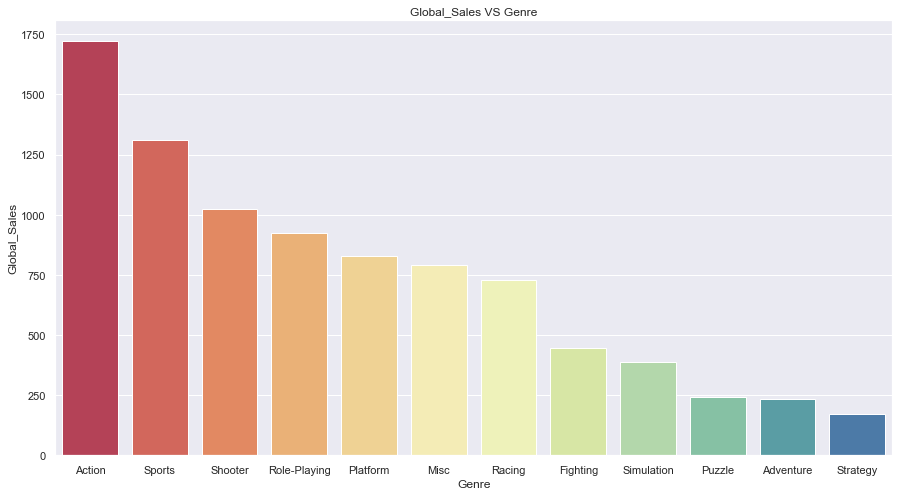

In [52]:
fig1,axes1=plt.subplots(figsize=(15,8))
sns.barplot(x='Genre',y='Global_Sales',data=df_genre,ax=axes1,estimator=np.sum,errcolor='r',capsize=0.2,errwidth=0.75,palette='Spectral')
axes1.set_xlabel('Genre')
axes1.set_ylabel('Global_Sales')
axes1.set_title('Global_Sales VS Genre')
plt.show()


> ### The results 
>- #### <span style="color:red"> ***Action*** , Sports and Shooter are always The Global's best-selling. </span>.
>

### The Platforms percentage

In [53]:
Platforms_value=Video_Games.Platform.value_counts()
other=pd.Series({'Others':Platforms_value[12:].sum()})
Platforms_value1=Platforms_value[:12].append(other)

In [54]:
Platforms_value1.index

Index(['DS', 'PS2', 'PS3', 'Wii', 'X360', 'PSP', 'PS', 'PC', 'XB', 'GBA', 'GC',
       '3DS', 'Others'],
      dtype='object')

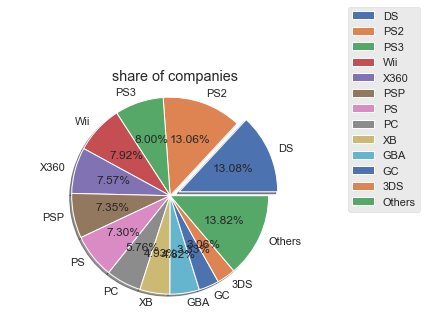

In [55]:
plt.pie(Platforms_value1,shadow=True
       ,labels=Platforms_value1.index,
        explode=(.1,0,0,0,0,0,0,0,0,0,0,0,0),
       autopct='%.2f%%' , startangle = 0)
plt.title('Percentage ofPlatforms')
plt.style.use('ggplot')
plt.axis('equal')
plt.title('share of companies')
plt.legend(loc=3,bbox_to_anchor=(1,0.4))



# 1.Numerical Data Ploting

In [56]:
Video_Games.head()

,Rank,Name,Platform,Year,Genre,Publisher,NorthAmerica_Sales,Europe_Sales,Japan_Sales,Other_Sales,Global_Sales,id
0,1,Wii Sports,Wii,2006,Sports,Nintendo,41.49,29.02,3.77,8.46,82.74,0
1,2,Super Mario Bros.,NES,1985,Platform,Nintendo,29.08,3.58,6.81,0.77,40.24,1
2,3,Mario Kart Wii,Wii,2008,Racing,Nintendo,15.85,12.88,3.79,3.31,35.83,2
3,4,Wii Sports Resort,Wii,2009,Sports,Nintendo,15.75,11.01,3.28,2.96,33.00,3
4,5,Pokemon Red/Pokemon Blue,GB,1996,Role-Playing,Nintendo,11.27,8.89,10.22,1.00,31.38,4


## <span style="color:#b5515b">What year did the games start and when did they stop, depending on the genre?</span>

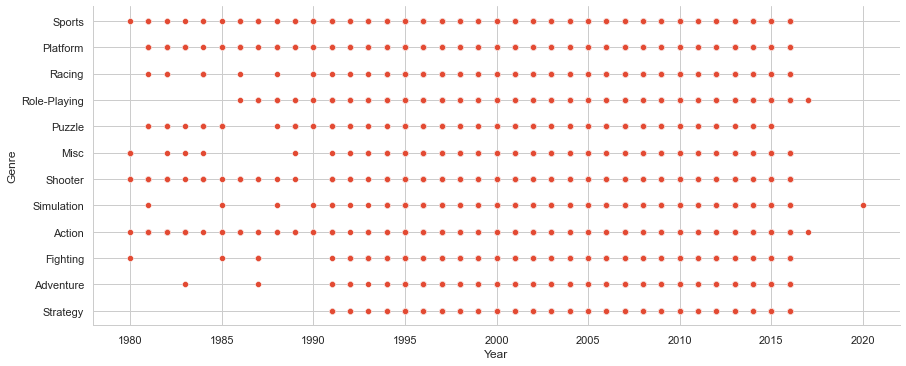

In [57]:
sns.set_style('whitegrid')
sns.relplot(y='Genre',x='Year',data=Video_Games,aspect=2.5)

> ### The results 
>- <span style="color:red">Sports Games started from 1980 to 2016 then stoped. </span>.
>- <span style="color:red">Simulation games stoped with Sports games and appear again in 2020. </span>.
>- <span style="color:red">strategy games started from 1991 to 2016 . </span>.


## <span style="color:#b5515b">What is the most popular game ?</span>

<AxesSubplot:xlabel='count', ylabel='Genre'>

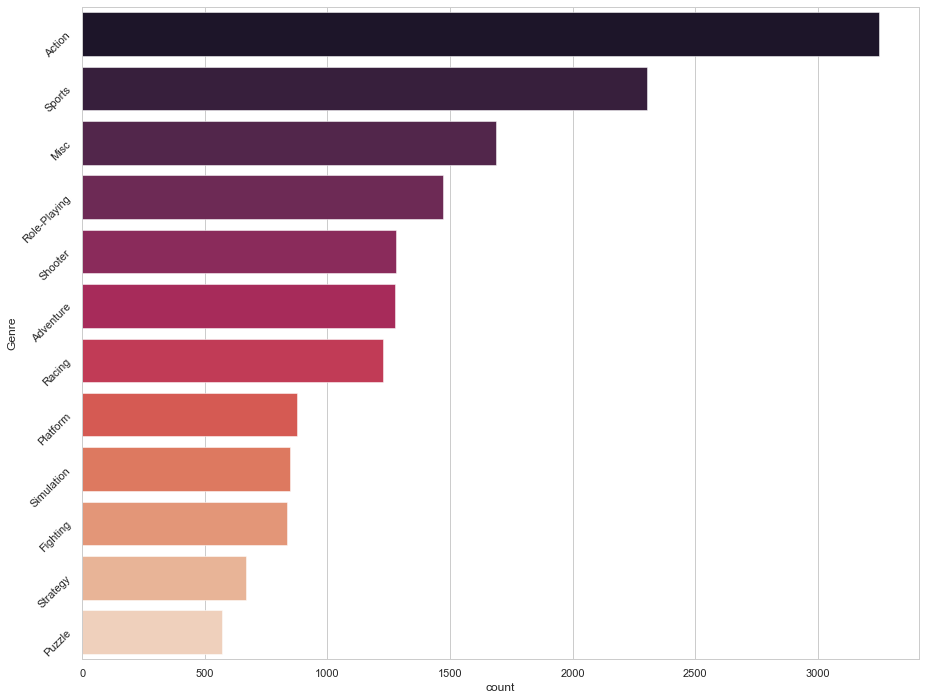

In [58]:
plt.figure(figsize=(15, 12))
plt.yticks(rotation=45)
sns.countplot(y="Genre", data=Video_Games , order = Video_Games['Genre'].value_counts().index, palette="rocket")

> ### The results 
>- <span style="color:red">Action and Sports Games are the most popular than others .</span>.



In [59]:
Video_Games['Platform'].value_counts()

DS      2131
PS2     2127
PS3     1304
Wii     1290
X360    1234
PSP     1197
PS      1189
PC       938
XB       803
GBA      786
GC       542
3DS      499
PSV      410
PS4      336
N64      316
SNES     239
XOne     213
SAT      173
WiiU     143
2600     116
NES       98
GB        97
DC        52
GEN       27
NG        12
WS         6
SCD        6
3DO        3
TG16       2
GG         1
PCFX       1
Name: Platform, dtype: int64

##  <span style="color:#b5515b">Which platform with the highest price individual game globally?</span>

In [60]:
"""strip", "swarm", "box", "violin",
    "boxen", "point", "bar", or "count"""

'strip", "swarm", "box", "violin",\n    "boxen", "point", "bar", or "count'

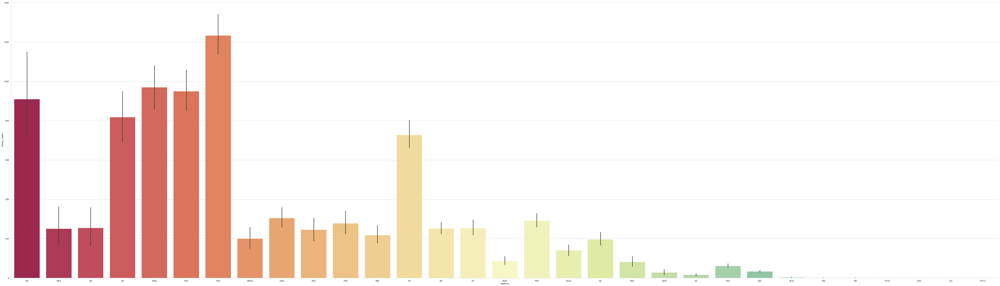

In [61]:
for i in range (1000,290,100):
    print (i)
    x=0
sns.catplot(x='Platform', y='Global_Sales',kind='bar',data=Video_Games,estimator=np.sum,palette='Spectral',aspect =3.5,height=20)


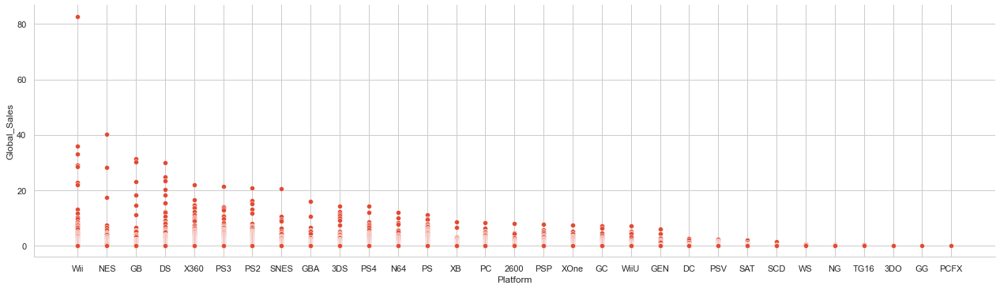

In [62]:
sns.relplot(x='Platform',y='Global_Sales',data = Video_Games ,aspect=3.5)

> ### The results 
>- <span style="color:red">WII Sports get the highest price individual game globally  .</span>.

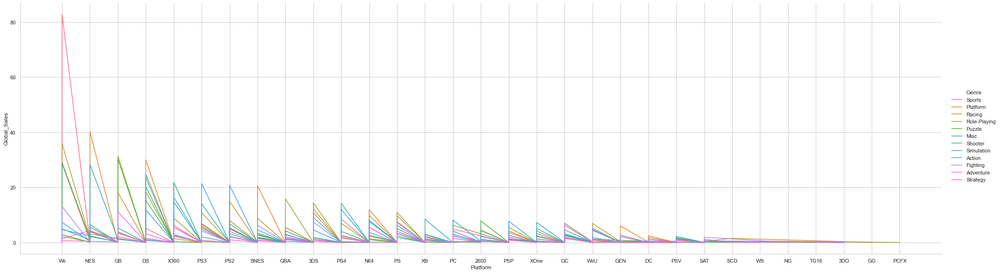

In [63]:
sns.relplot(x='Platform',y='Global_Sales',data= Video_Games,kind='line',hue="Genre",estimator=None,aspect=3.5,height=8)

> ### The results 
>- <span style="color:red">WII Sports get the highest price individual game globally with sports genre  .</span>.

In [64]:
Video_Games.columns

Index(['Rank', 'Name', 'Platform', 'Year', 'Genre', 'Publisher',
       'NorthAmerica_Sales', 'Europe_Sales', 'Japan_Sales', 'Other_Sales',
       'Global_Sales', 'id'],
      dtype='object')

In [65]:
G_S_Year=Video_Games.groupby(by=['Year'])[['NorthAmerica_Sales', 'Europe_Sales', 'Japan_Sales', 'Other_Sales','Global_Sales']].sum()
G_S_Year=G_S_Year.reset_index()
S_Gl_Year=G_S_Year.sort_values(by=['Global_Sales'],ascending=False)
S_NA_Y=G_S_Year.sort_values(by=['NorthAmerica_Sales'],ascending=False)
S_EU_Y=G_S_Year.sort_values(by=['Europe_Sales'],ascending=False)
S_JP_Y=G_S_Year.sort_values(by=['Japan_Sales'],ascending=False)
S_other_Y=G_S_Year.sort_values(by=['Other_Sales'],ascending=False)
G_S_Year

,Year,NorthAmerica_Sales,Europe_Sales,Japan_Sales,Other_Sales,Global_Sales
0,1980,10.59,0.67,0.00,0.12,11.38
1,1981,33.40,1.96,0.00,0.32,35.68
2,1982,26.92,1.65,0.00,0.31,28.88
3,1983,7.76,0.80,8.10,0.14,16.80
4,1984,33.28,2.10,14.27,0.70,50.35
5,1985,33.73,4.74,14.56,0.92,53.95
6,1986,12.50,2.84,19.81,1.93,37.08
7,1987,8.46,1.41,11.63,0.20,21.70
8,1988,23.87,6.59,15.76,0.99,47.21
9,1989,45.15,8.44,18.36,1.50,73.45


In [66]:
f = go.FigureWidget()
f.add_bar(x=G_S_Year['Year'],y=G_S_Year['NorthAmerica_Sales'],name='NorthAmerica_Sales')
f.add_bar(x=G_S_Year['Year'],y=G_S_Year['Europe_Sales'],name='Europe_Sales')
f.add_bar(x=G_S_Year['Year'],y=G_S_Year['Japan_Sales'],name='Japan_Sales')
f.add_bar(x=G_S_Year['Year'],y=G_S_Year['Other_Sales'],name='Other_Sales')
f.layout.title = 'Regions sales as part of Global Sales by Year'
f

FigureWidget({
    'data': [{'name': 'NorthAmerica_Sales',
              'type': 'bar',
              'uid': '…

In [67]:
f.add_scatter(x=G_S_Year['Year'],y=G_S_Year['Global_Sales'],name='Global_Sales')
f

FigureWidget({
    'data': [{'name': 'NorthAmerica_Sales',
              'type': 'bar',
              'uid': '…

##  <span style="color:#b5515b">Which platform with the highest price individual game globally?</span>

In [68]:
Genre_Sales = Video_Games[['Genre', 'NorthAmerica_Sales', 'Europe_Sales', 'Japan_Sales', 'Other_Sales',]]
# comp_genre
hex_map = Genre_Sales.groupby(by=['Genre']).sum()
# comp_map
hex_map

,NorthAmerica_Sales,Europe_Sales,Japan_Sales,Other_Sales
Genre,,,,
Action,861.77,516.48,158.65,184.92
Adventure,101.93,63.74,51.99,16.70
Fighting,220.74,100.00,87.15,36.19
Misc,396.92,211.77,106.67,73.92
Platform,445.99,200.65,130.65,51.51
Puzzle,122.01,50.52,56.68,12.47
Racing,356.93,236.31,56.61,76.68
Role-Playing,326.50,187.57,350.29,59.38
Shooter,575.16,310.45,38.18,101.90


<AxesSubplot:ylabel='Genre'>

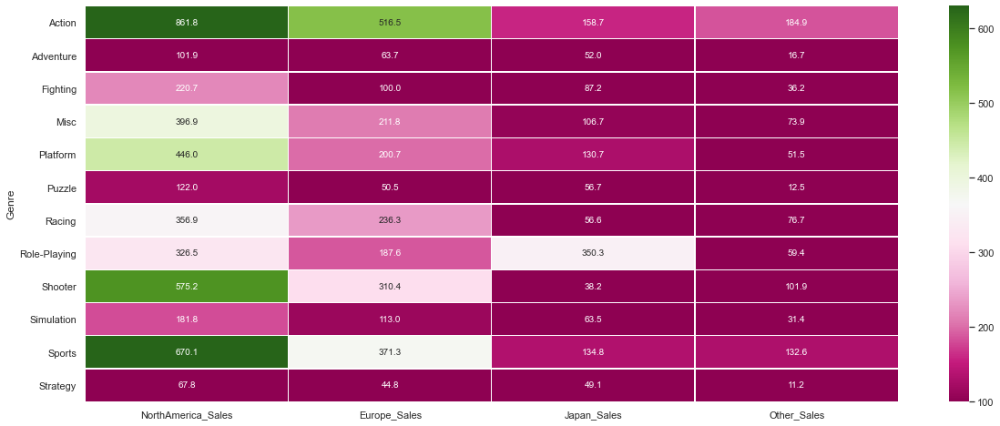

In [69]:
sns.color_palette("Set2")
fig1,axes1=plt.subplots(figsize=(20,8),)
sns.heatmap(data=hex_map,vmin=100,vmax=630,annot=True,linewidth=0.3,cbar=True, fmt = '.1f', cmap="PiYG")

> ### The results 
>- <span style="color:red">North America is the most popular region for video games without a competitor  .</span>.

In [70]:
Video_Games.drop(['id'], axis=1)

,Rank,Name,Platform,Year,Genre,Publisher,NorthAmerica_Sales,Europe_Sales,Japan_Sales,Other_Sales,Global_Sales
0,1,Wii Sports,Wii,2006,Sports,Nintendo,41.49,29.02,3.77,8.46,82.74
1,2,Super Mario Bros.,NES,1985,Platform,Nintendo,29.08,3.58,6.81,0.77,40.24
2,3,Mario Kart Wii,Wii,2008,Racing,Nintendo,15.85,12.88,3.79,3.31,35.83
3,4,Wii Sports Resort,Wii,2009,Sports,Nintendo,15.75,11.01,3.28,2.96,33.00
4,5,Pokemon Red/Pokemon Blue,GB,1996,Role-Playing,Nintendo,11.27,8.89,10.22,1.00,31.38
5,6,Tetris,GB,1989,Puzzle,Nintendo,23.20,2.26,4.22,0.58,30.26
6,7,New Super Mario Bros.,DS,2006,Platform,Nintendo,11.38,9.23,6.50,2.90,30.01
7,8,Wii Play,Wii,2006,Misc,Nintendo,14.03,9.20,2.93,2.85,29.01
8,9,New Super Mario Bros. Wii,Wii,2009,Platform,Nintendo,14.59,7.06,4.70,2.26,28.61
9,10,Duck Hunt,NES,1984,Shooter,Nintendo,26.93,0.63,0.28,0.47,28.31


<AxesSubplot:>

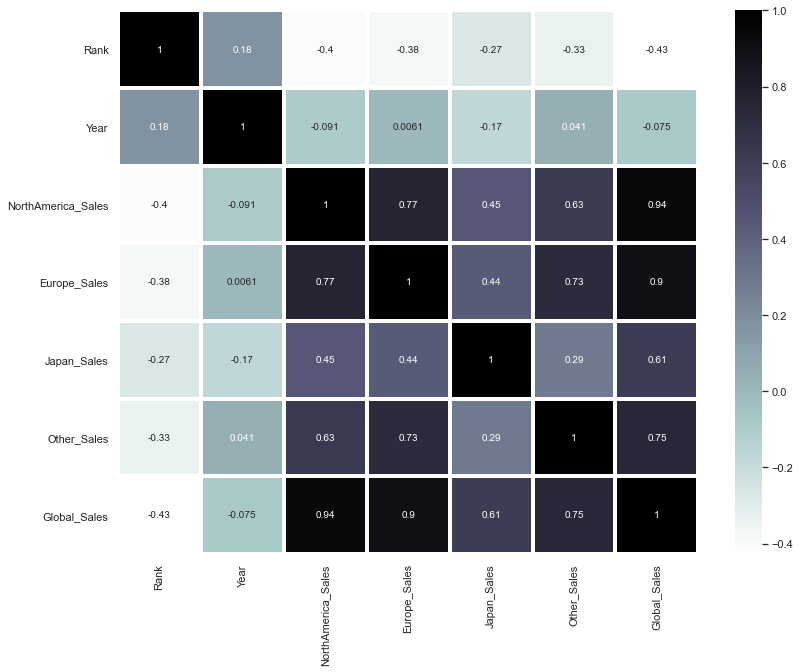

In [71]:
plt.figure(figsize=(13,10))
sns.heatmap(Video_Games.drop(['id'], axis=1).corr(), cmap = "bone_r", annot=True, linewidth=3)

> ### The results 
>- <span style="color:red">North America is The biggest influencer in the world price without a competitor  .</span>.

##  <span style="color:#b5515b">Machine Learning Models</span>

<a id='4'></a>

In [72]:
Video_Games.columns

Index(['Rank', 'Name', 'Platform', 'Year', 'Genre', 'Publisher',
       'NorthAmerica_Sales', 'Europe_Sales', 'Japan_Sales', 'Other_Sales',
       'Global_Sales', 'id'],
      dtype='object')

In [73]:
# Using labelEncoder convert categorical data into numerical data
columns=[ 'Platform',  'Genre', 'Publisher']
number=LabelEncoder()
for i in columns:
    Video_Games[f'{i}']=number.fit_transform(Video_Games[f'{i}'].astype('str'))

In [74]:
Video_Games1=Video_Games.drop(['Rank',"Name", 'Year','id'],axis=1)
Video_Games3=Video_Games.drop(['NorthAmerica_Sales','Europe_Sales', 'Japan_Sales', 'Other_Sales','id'],axis=1)

In [75]:
Video_Games1

,Platform,Genre,Publisher,NorthAmerica_Sales,Europe_Sales,Japan_Sales,Other_Sales,Global_Sales
0,26,10,359,41.49,29.02,3.77,8.46,82.74
1,11,4,359,29.08,3.58,6.81,0.77,40.24
2,26,6,359,15.85,12.88,3.79,3.31,35.83
3,26,10,359,15.75,11.01,3.28,2.96,33.00
4,5,7,359,11.27,8.89,10.22,1.00,31.38
5,5,5,359,23.20,2.26,4.22,0.58,30.26
6,4,4,359,11.38,9.23,6.50,2.90,30.01
7,26,3,359,14.03,9.20,2.93,2.85,29.01
8,26,4,359,14.59,7.06,4.70,2.26,28.61
9,11,8,359,26.93,0.63,0.28,0.47,28.31


In [76]:
columns=['Platform', 'Genre', 'Publisher', 'NorthAmerica_Sales','Europe_Sales']

In [77]:
labels=Video_Games3['Global_Sales'].values
features=Video_Games1[list(columns)].values
x=features
y=labels

In [78]:
y

array([8.274e+01, 4.024e+01, 3.583e+01, ..., 0.000e+00, 1.000e-02,
       1.000e-02])

In [79]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.30)

In [80]:
print(x_train.size,x_test.size,y_train.size,y_test.size)

57015 24440 11403 4888


##  <span style="color:#b5515b">Scaling</span>

In [81]:
scaler=StandardScaler()

In [82]:
# Fit only on training data 
scaler.fit(x_train)
x_train=scaler.transform(x_train)

In [83]:
# apply same transformation to test data
x_test = scaler.transform(x_test)

In [84]:
x_test.size,

(24440,)

In [85]:
y_test.size

4888

##  <span style="color:#b5515b">Linear Regression Model</span>

In [86]:
#training model
regr = linear_model.LinearRegression()
regr.fit(x_train,y_train)
accuracy=regr.score(x_train,y_train)
y_pred=regr.predict(x_test)
print('Linear Regression Accuracy in the training data :' , accuracy*100 , "%")
Test_accuracy=regr.score(x_test,y_test)
print('Linear Regression Accuracy in the test data :' , Test_accuracy*100 , "%")

Linear Regression Accuracy in the training data : 96.3544713745048 %
Linear Regression Accuracy in the test data : 96.75934872525634 %


In [87]:
cutoff = 0.7                              # decide on a cutoff limit
y_pred_classes = np.zeros_like(y_pred)    # initialise a matrix full with zeros
y_pred_classes[y_pred > cutoff] = 1            # add a 1 if the cutoff was breached                   
y_test_classes = np.zeros_like(y_pred)
y_test_classes[y_test > cutoff] = 1
accuracy_score(y_test_classes,y_pred_classes)

0.9678805237315876

In [88]:
confusion_matrix(y_test_classes,y_pred_classes)

array([[3950,   95],
       [  62,  781]], dtype=int64)

In [89]:
recall_score(y_test_classes,y_pred_classes)
precision_score(y_test_classes,y_pred_classes,average=None)
f1_score(y_test_classes,y_pred_classes,average=None)
print(classification_report(y_test_classes,y_pred_classes))

              precision    recall  f1-score   support

         0.0       0.98      0.98      0.98      4045
         1.0       0.89      0.93      0.91       843

    accuracy                           0.97      4888
   macro avg       0.94      0.95      0.94      4888
weighted avg       0.97      0.97      0.97      4888



##  <span style="color:#b5515b">GradientBoostingRegressor Model</span>

In [90]:
from sklearn.ensemble import GradientBoostingRegressor
GBR=GradientBoostingRegressor()
GBR.fit(x_train,y_train)
GBR_accuracy=GBR.score(x_train,y_train)
y_pred=GBR.predict(x_test)
print('GradientBoostingRegressor Accuracy in the training data :' , GBR_accuracy*100 , "%%!!")
GBR_Test_accuracy=GBR.score(x_test,y_test)
print('GradientBoostingRegressor Accuracy in the test data :' , GBR_Test_accuracy*100 , "%")

GradientBoostingRegressor Accuracy in the training data : 97.94513887430352 %%!!
GradientBoostingRegressor Accuracy in the test data : 83.2042273013862 %


##  <span style="color:#b5515b">DecisionTreeRegressor Model</span>

In [91]:
from sklearn.tree import DecisionTreeRegressor
DT=DecisionTreeRegressor()
DT.fit(x_train,y_train)
DT_accuracy=DT.score(x_train,y_train)
y_pred=DT.predict(x_test)
print('DecisionTree Accuracy in the training data :' , DT_accuracy*100 , "%")
DT_Test_accuracy=DT.score(x_test,y_test)
print('DecisionTree Accuracy in the test data :' , DT_Test_accuracy*100 , "%")

DecisionTree Accuracy in the training data : 99.69383951540924 %
DecisionTree Accuracy in the test data : 84.69111411111908 %


##  <span style="color:#b5515b">RandomForestRegressor Model</span>

In [92]:
from sklearn.ensemble import RandomForestRegressor
RF=RandomForestRegressor()
RF.fit(x_train,y_train)
RF_accuracy=RF.score(x_train,y_train)
print('RandomForest Accuracy in the training data :' , RF_accuracy*100 , "%")
RF_Test_accuracy=RF.score(x_test,y_test)
print('RandomForest Accuracy in the test data :' , RF_Test_accuracy*100 , "%")

RandomForest Accuracy in the training data : 99.12451350409542 %
RandomForest Accuracy in the test data : 83.62092427108637 %


##  <span style="color:#b5515b">SVR Model</span>

In [93]:
from sklearn.svm import SVR
SVR=SVR()
SVR.fit(x_train,y_train)
y_pred=SVR.predict(x_test)
SVR_accuracy=SVR.score(x_train,y_train)
print('SVR Accuracy in the training data :' , SVR_accuracy*100 , "%")
SVR_Test_accuracy=SVR.score(x_test,y_test)
print('SVR Accuracy in the test data :' , SVR_Test_accuracy*100 , "%")

SVR Accuracy in the training data : 67.61272503390877 %
SVR Accuracy in the test data : 42.592848940535944 %


##  <span style="color:#b5515b">Machine learning methods visualization</span>

In [94]:
data = {'Model Name':['Linear Regression','GradientBoosting', 'DecisionTree', 'RandomForest', 'SVR'], 
        'training data Accuracy':[accuracy,GBR_accuracy, DT_accuracy, RF_accuracy, SVR_accuracy], 
        'testing data Accuracy':[Test_accuracy,GBR_Test_accuracy, DT_Test_accuracy, RF_Test_accuracy, SVR_Test_accuracy]}
Ms=pd.DataFrame(data)
Ms

,Model Name,training data Accuracy,testing data Accuracy
0,Linear Regression,0.963545,0.967593
1,GradientBoosting,0.979451,0.832042
2,DecisionTree,0.996938,0.846911
3,RandomForest,0.991245,0.836209
4,SVR,0.676127,0.425928


In [95]:
fig = px.bar(Ms, x='Model Name', y='training data Accuracy',color='testing data Accuracy')
fig.show()

# <span style="color:#AE5FE8">Thank You</span>